# Color Models
---
- Author: Diego Inácio
- GitHub: [github.com/diegoinacio](https://github.com/diegoinacio)
- Notebook: [color_models.ipynb](https://github.com/diegoinacio/computer-vision-notebooks/blob/master/Computer-Vision-Fundamentals/color_models.ipynb)
---
A brief overview of the main color models with interactive visualization.

In [1]:
from color_model_plot import *

import numpy as np
from PIL import Image

from _utils import *

## 0. Input image
---

In [2]:
img_in = Image.open('../_data/babuino.png')
img_in = img_in.resize((128, 128), Image.ANTIALIAS)
img_in = np.asarray(img_in)/255

In [3]:
summary(img_in)

                          R               G               B
       min:          0.0706          0.0431          0.0039
  1st Quar:          0.3882          0.3804          0.2824
    median:          0.5137          0.5059          0.3961
      mean:          0.5391          0.5056          0.4438
  3rd Quar:          0.6588          0.6314          0.5608
       max:          0.9961          0.8392          1.0000
     sigma:          0.2009          0.1595          0.2215


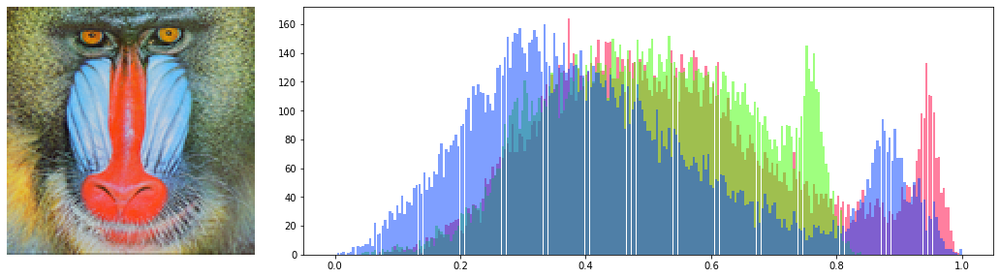

In [4]:
histogram(img_in, interval=[0, 1])

## 1. RGB color model
---
Color model based on the cartesian coordinates, where each primary color is represented by an axis.

In [5]:
N1, N2, C = img_in.shape
RGB = img_in.reshape(-1, C)

plotRGB(RGB)

## 2. XYZ color model
---
$$ \large
\left[
    \begin{array}{c}
        X\\Y\\Z
    \end{array}
\right]
=
\left[
    \begin{array}{ccc}
        0.490 & 0.310 & 0.200\\
        0.177 & 0.813 & 0.010\\
        0.000 & 0.010 & 0.990
    \end{array}
\right]
\left[
    \begin{array}{c}
        R\\G\\B
    \end{array}
\right]
$$


In [6]:
# Color model
m = np.array([
    [0.490, 0.310, 0.200],
    [0.177, 0.813, 0.010],
    [0.000, 0.010, 0.990]
])
XYZ = np.dot(m, RGB.T).T

plotXYZ(XYZ, RGB, m)

## 2. YIQ color model
---
$$ \large
\left[
    \begin{array}{c}
        Y\\I\\Q
    \end{array}
\right]
=
\left[
    \begin{array}{ccc}
        0.299 & 0.587 & 0.114\\
        0.596 & -0.275 & -0.321\\
        0.212 & -0.523 & 0.331
    \end{array}
\right]
\left[
    \begin{array}{c}
        R\\G\\B
    \end{array}
\right]
$$


In [7]:
# Color model
m = np.array([
    [0.299, 0.587, 0.114],
    [0.596, -0.275, -0.321],
    [0.212, -0.523, 0.311]
])
YIQ = np.dot(m, RGB.T).T

plotXYZ(YIQ, RGB, m)

## 3. YUV color model
---
$$ \large
\left[
    \begin{array}{c}
        Y\\U\\V
    \end{array}
\right]
=
\left[
    \begin{array}{ccc}
        0.299 & 0.587 & 0.114\\
        -0.147 & -0.289 & 0.436\\
        0.615 & -0.515 & -0.100
    \end{array}
\right]
\left[
    \begin{array}{c}
        R\\G\\B
    \end{array}
\right]
$$


In [8]:
# Color model
m = np.array([
    [0.299, 0.587, 0.114],
    [-0.147, -0.289, 0.436],
    [0.615, -0.515, -0.100]
])
YUV = np.dot(m, RGB.T).T

plotXYZ(YUV, RGB, m)

## 4. $YC_BC_R$ color model
---
$$ \large
\left[
    \begin{array}{c}
        Y\\C_B\\C_R
    \end{array}
\right]
=
\left[
    \begin{array}{ccc}
        0.299 & 0.587 & 0.114\\
        -0.169 & -0.331 & 0.500\\
        0.500 & -0.419 & -0.081
    \end{array}
\right]
\left[
    \begin{array}{c}
        R\\G\\B
    \end{array}
\right]
$$


In [9]:
# Color model
m = np.array([
    [ 0.299,  0.587,  0.114],
    [-0.169, -0.331,  0.500],
    [ 0.500, -0.419, -0.081]
])
YCbCr = np.dot(m, RGB.T).T

plotXYZ(YCbCr, RGB, m)

## 5. HSV color model
---
$$ \large
H = \begin{cases}
    60\frac{G-B}{M-m} &     \text{, if $M = R$} \\
    60\frac{B-R}{M-m}+120 & \text{, if $M = G$} \\
    60\frac{R-G}{M-m}+240 & \text{, if $M = B$}
\end{cases}
\quad;\quad
S = \begin{cases}
    \frac{M-m}{M} & \text{, if $M \neq 0$} \\
    0             & \text{, otherwise}
\end{cases}
\quad;\quad
V = M
$$

In [10]:
# Color model
R, G, B = RGB.T
m, M = np.min(RGB, axis=1), np.max(RGB, axis=1)

H = np.zeros(R.size)

H = np.where(M == R, 60*(G - B)/(M - m)      , H)
H = np.where(M == G, 60*(B - R)/(M - m) + 120, H)
H = np.where(M == B, 60*(R - G)/(M - m) + 240, H)

S = np.zeros(G.size)

S = np.where(M != 0, (M - m)/M, S)

HSV = np.zeros(RGB.shape)

HSV[:, 0] = H
HSV[:, 1] = S
HSV[:, 2] = M

plotHSV(HSV, RGB)

## 6. HSL color model
---
$$ \large
H = \begin{cases}
    60\frac{G-B}{M-m} &     \text{, if $M = R$} \\
    60\frac{B-R}{M-m}+120 & \text{, if $M = G$} \\
    60\frac{R-G}{M-m}+240 & \text{, if $M = B$}
\end{cases}
\quad;\quad
S = \begin{cases}
    0             & \text{, if M=m} \\
    \frac{M-m}{M+m} & \text{, if $0 < L \leq 0.5$} \\
    \frac{M-m}{2-(M+m)} & \text{, $L > 0.5$}
\end{cases}
\quad;\quad
L = \frac{M+m}{2}
$$

In [11]:
# Color model
R, G, B = RGB.T
m, M = np.min(RGB, axis=1), np.max(RGB, axis=1)

H = np.zeros(R.size)

H = np.where(M == R, 60*(G - B)/(M - m)      , H)
H = np.where(M == G, 60*(B - R)/(M - m) + 120, H)
H = np.where(M == B, 60*(R - G)/(M - m) + 240, H)

L = (M + m)/2

S = np.zeros(G.size)

S = np.where(L <= 0.5, (M - m)/(M + m), S)
S = np.where(L > 0.5, (M - m)/(2 - (M + m)), S)

HSL = np.zeros(RGB.shape)

HSL[:, 0] = H
HSL[:, 1] = S
HSL[:, 2] = L

plotHSL(HSL, RGB)